# Mapping Census Data using Plotly

By Kenneth Burchfiel

Released under the MIT license

This script will demonstrate how to use Plotly's `px.choropleth()` and `px.choropleth_map()` functions to create *choropleth maps* that visualize population growth rates. (These growth rates were calculated using 'census_data_imports_v2.ipynb' (https://github.com/kburchfiel/pfn/blob/main/Census_Data_Imports/census_data_imports_v2.ipynb) within PFN's Census Data Imports section. This notebook will also show how to improve maps' readability by basing choropleth colors on percentiles.

*When running the notebook on your computer, I recommend setting the `render_for_pdf` variable within the Appendix's helper_funcs.py file to False in order to allow interactive, rather than static maps, to appear. (This will also allow more DataFrame columns visible within the notebook's output.*)

**A primer on choropleth maps**

Choropleth maps assign different colors to different regions depending on an underlying data point. Perhaps the most famous example of choropleth maps, at least in the US, are presidential election maps. Recent versions of these maps assign red and blue colors to states that are won by the Republican and Democratic nominees for president, respectively. They're a ubiquitous sight on election nights, as they provide useful overviews of which states have been called for a particular candidate so far.

Our population growth maps will differ from these election maps in that colors will be assigned based on numerical data (growth rates) rather than categorical data (presidential parties). States and counties with the highest growth rates will be colored orange whereas those with the lowest rates will be colored purple. 

## A note on Plotly vs. Folium

I used to use Folium (https://python-visualization.github.io/folium/latest/) as my main Python mapping library. However, I decided to switch to Plotly for two main reasons:

1. The process of creating static copies of maps within Python is much, much simpler with Plotly than with Folium. The latter process is absolutely doable (as you'll learn in the Folium map chapter), but I found it challenging to create matching static and interactive copies of the same map.

2. Plotly makes it easy to render Alaska and Hawaii near the lower 48 US states; this greatly simplifies the process of creating static choropleth maps that show the entire US.

However, in your own work, you may want (or need) to use Folium rather than Plotly. In that case, make sure to check out the 'choropleth_maps_with_folium.ipynb' notebook and its corresponding 'folium_choropleth_map_functions.py' Python file. (These will be introduced soon in the book version of PFN.)

In [1]:
import time
start_time = time.time()
import pandas as pd
pd.set_option('display.max_columns', 1000)
import geopandas
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
from IPython.display import Image # Source: StacKOverflow user 'zach' at
# https://stackoverflow.com/a/11855133/13097194

import sys
sys.path.insert(1, '../Appendix')
from helper_funcs import config_notebook, wadi
display_type = config_notebook(display_max_columns = 5)

from plotly_choropleth_map_functions import update_and_save_plotly_map, \
gen_choropleth, gen_choropleth_map


## Importing data to be mapped

Choropleth maps require two sets of data: (1) boundary data that allows outlines of regions to get drawn and (2) a metric that determines how those boundaries should get colored. The following cells will import county-level boundary data and population growth metrics, thus allowing us to visualize population change by county.

### Importing 2021 County Shapefiles

These shapefiles show the outlines of each US county. They can be accessed by downloading the shapefile folder located at https://www2.census.gov/geo/tiger/GENZ2021/shp/cb_2021_us_county_500k.zip . (If this link doesn't work, try navigating to https://www.census.gov/geographies/mapping-files/time-series/geo/cartographic-boundary.2021.html ; scrolling down to the **Counties** header; and then clicking on the 'shapefile' link that appears to the right of the "1 : 500,000 (national)" text. 

This shapefile folder contains unzipped 1:500,000-scale versions of the county shapefiles available on the Census website. (I could also have downloaded less detailed shapefiles, which feature smaller file sizes, but it's easy to create simplified versions of these outlines via Python--which I'll demonstrate in the following cell.)

Note that each folder contains a number of files. My experience has been that *all* of these files need to be present in the folder containing a given shapefile in order for that shapefile to work correctly within Python. Your experience may vary, though.

**Note**: I chose to import *2021* shapefiles because copies for later years did not contain the original Connecticut counties found within my corresponding population growth dataset. If your own dataset references Connecticut's planning regions (https://en.wikipedia.org/wiki/Councils_of_governments_in_Connecticut) rather than counties, you'll most likely want to use a county dataset from 2022 or later.

In [2]:
gdf_counties = geopandas.read_file(
    'shapefiles/cb_2021_us_county_500k/cb_2021_us_county_500k.shp')

# Simplifying boundaries:
# You can experiment with different 'tolerance' arguments to find the
# right balance between accuracy and size/rendering speed for your project.
# 0.005 tends to be my preferred default setting.
gdf_counties['geometry'] = gdf_counties['geometry'].simplify(
    tolerance = 0.005)

# Creating a column that combines county names and long state names:
# (This column can then serve as a key for an upcoming merge.)
# 'STATE_NAME' is used rather than 'STUSPS' for the state 
# component of this column so that the column will match the format used 
# within our demographic dataset.
gdf_counties.insert(
    0, 'County/State', 
    gdf_counties['NAMELSAD'] + ', ' + gdf_counties['STATE_NAME'])
gdf_counties.head()

,County/State,STATEFP,...,AWATER,geometry
0,"Riley County, Kansas",20,...,32047392,"POLYGON ((-96.96169 39.22008, -96.95872 39.566..."
1,"Ringgold County, Iowa",19,...,8723135,"POLYGON ((-94.47121 40.57082, -94.47078 40.899..."
2,"Carbon County, Montana",30,...,35213028,"POLYGON ((-109.79867 45.16734, -109.68779 45.1..."
3,"Bear Lake County, Idaho",16,...,191364281,"POLYGON ((-111.63452 42.57034, -111.60312 42.5..."
4,"Buffalo County, Wisconsin",55,...,87549529,"POLYGON ((-92.08384 44.412, -92.04391 44.51238..."


Confirming that this dataset contains Connecticut's former counties rather than planning regions:

In [3]:
gdf_counties.query("STATEFP == '09'").head() 

,County/State,STATEFP,...,AWATER,geometry
60,"New London County, Connecticut",09,...,276863144,"MULTIPOLYGON (((-72.2239 41.29346, -72.22523 4..."
306,"Fairfield County, Connecticut",09,...,549280913,"MULTIPOLYGON (((-73.21763 41.14235, -73.21499 ..."
911,"Middlesex County, Connecticut",09,...,180679141,"POLYGON ((-72.75294 41.5925, -72.71454 41.6043..."
935,"New Haven County, Connecticut",09,...,667604268,"MULTIPOLYGON (((-72.76143 41.24233, -72.75886 ..."
2245,"Windham County, Connecticut",09,...,21478813,"POLYGON ((-72.25208 41.72706, -72.19813 41.728..."


(Our population growth dataset uses these counties as well, so we'll
be able to merge the county data and boundaries together without
any issues.)

### Importing growth data for US counties

Now that we've loaded in our region boundaries, we can turn our attention to the county-level population growth data that our first sets of choropleth maps will visualize.

The following table was created within the Census Data Imports section of Python for Nonprofits.

In [4]:
df_acs_county_growth = pd.read_csv(
    f'../Census_Data_Imports/Datasets/\
grad_destinations_acs_county_data.csv')
# Renaming the NAME column in order to avoid a conflict with our shapefile
# dataset's NAME column:
df_acs_county_growth.rename(
    columns = {'NAME':'County/State'},
    inplace = True)
df_acs_county_growth.head()

,County/State,county,...,2016-2021 Total_Pop_25_to_29 % Change Rank,2016-2021 Total_Pop_25_to_29 % Change Percentile
0,"Abbeville County, South Carolina",1,...,1357.0,56.829035
1,"Acadia Parish, Louisiana",1,...,2812.0,10.506208
2,"Accomack County, Virginia",1,...,1426.0,54.632283
3,"Ada County, Idaho",1,...,869.0,72.365489
4,"Adair County, Iowa",1,...,588.0,81.311684


Merging our Census data into our county shapefiles:

(We could also have used state and county codes for this merge; however, I prefer to merge on names when possible, as there's always a chance that codes within two different datasets might refer to different regions.)

In [5]:
gdf_counties_and_growth_stats = gdf_counties.merge(
    df_acs_county_growth, on = 'County/State', how = 'inner')
# Limiting the results to just the 50 US states plus DC:
gdf_counties_and_growth_stats.query("STUSPS != 'PR'", inplace = True)
gdf_counties_and_growth_stats.head()

,County/State,STATEFP,...,2016-2021 Total_Pop_25_to_29 % Change Rank,2016-2021 Total_Pop_25_to_29 % Change Percentile
0,"Riley County, Kansas",20,...,2912.0,7.322509
1,"Ringgold County, Iowa",19,...,2979.0,5.189430
2,"Carbon County, Montana",30,...,2323.0,26.074499
3,"Bear Lake County, Idaho",16,...,2684.0,14.581344
4,"Buffalo County, Wisconsin",55,...,2289.0,27.156956


Determining which set of growth data to visualize within our map:

In [6]:
year_range_end = 2021
year_range_start = year_range_end - 10
year_range = f'{year_range_start}-{year_range_end}'
year_range

'2011-2021'

Filtering our DataFrame to include only those fields that we'll need for our map and removing rows that lack entries for the field to be visualized:

In [7]:
data_col = f'{year_range} Total_Pop % Change'

# Specifying an additional column that will get included within the maps' 
# hover data (e.g. information that pops up when viewers move their mouse 
# over a particular region):

extra_hover_data = [
    f'{data_col} Rank']

# Percentile information will get added in automatically by a mapping
# function that we'll use later within this script (as long as its
# 'percentile' argument is set to True), so we won't add that to the
# extra_hover_data field here.

gdf_counties_for_map = gdf_counties_and_growth_stats.copy().dropna(
    subset = data_col).sort_values(data_col, ascending = False).set_index(
    'County/State')[
['geometry',data_col, '2011-2021 Total_Pop % Change Percentile'] 
+ extra_hover_data].copy()

gdf_counties_for_map

,geometry,2011-2021 Total_Pop % Change,2011-2021 Total_Pop % Change Percentile,2011-2021 Total_Pop % Change Rank
County/State,,,,
"McKenzie County, North Dakota","POLYGON ((-104.04531 47.33014, -104.04412 47.9...",119.770042,100.000000,1.0
"Williams County, North Dakota","POLYGON ((-104.04412 47.99608, -104.04758 48.6...",74.453416,99.968122,2.0
...,...,...,...,...
"Blaine County, Nebraska","POLYGON ((-100.26762 42.08615, -99.68696 42.08...",-40.854701,0.063755,3136.0
"Kenedy County, Texas","MULTIPOLYGON (((-97.39839 26.86789, -97.38686 ...",-48.000000,0.031878,3137.0


**Important: In order for your mapping code to work correctly, it is crucial that your indices contain the location values that you wish to use (e.g. county or state names). If you instead use a regular numerical index (e.g. 0 . . . n), it appears that `px.choropleth()` may interpret those index names as state or county FIPS codes, depending perhaps on the `scope` argument that you pass to that function. This will likely cause *the wrong data to get shown for certain locations.***

Defining a custom color scale: (This step is optional, but I wanted to demonstrate how you can send a custom scale to your map if needed. Plotly will automatically interpolate between these colors when determining which colors to use within your map.)

In [8]:
custom_color_scale = ['#800080', '#ffffff', '#ffa500'] # Purple, 
# white, and orange. See https://en.wikipedia.org/wiki/Web_colors
# for more details on basic html colors like these.

Specifying the default static and html folder paths for maps:

In [9]:
static_file_folder = 'map_screenshots'
html_file_folder = 'maps'

## Creating an initial choropleth map with a linear scale

The following code successfully creates a choropleth map using Plotly. Setting `scope` to 'usa' allows a special US-based projection to be used; this projection places Alaska and Hawaii to the southwest of the contiguous US, which is very convenient for static map copies. 

(Within the `px.choropleth()` call, note that the `geojson` argument needs to be your actual set of region polygons rather than the name of the column (in this case, 'geometry') that stores those polygons.

In [10]:
data_col

'2011-2021 Total_Pop % Change'

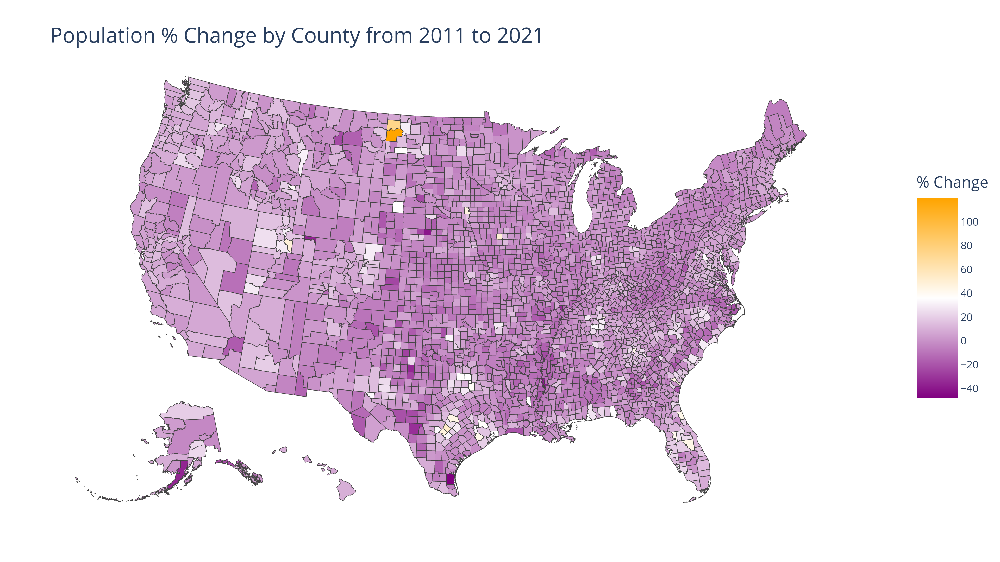

In [11]:
fig = px.choropleth(
    gdf_counties_for_map, 
    geojson = gdf_counties_for_map['geometry'],
    locations = gdf_counties_for_map.index,
    color = data_col,
    scope = 'usa',
    color_continuous_scale = custom_color_scale,
    basemap_visible = False,
    title = f'Population % Change by County from {year_range_start} \
to {year_range_end}')



# Shortening our colorbar title:
fig.update_coloraxes(colorbar_title = "% Change")
# (This code was based on the documentation found at
# https://plotly.com/python/reference/layout/coloraxis/)

# I found that the basemap's presence made certain coastal county borders 
# appear a bit 'messy', so I decided to disable it.

# Saving this map as an image file: 
# (Consult the update_and_save_plotly_map() documentation within
# plotly_choropleth_map_functions.py for more details on the function
# called below.)
filename = 'sample_linear_map'
update_and_save_plotly_map(
    fig, static_file_folder = static_file_folder, filename = filename, 
    save_html = False)

# Calling wadi() to display the map we just created:
# (Because a .png version of this image has already been created,
# we'll set generate_image to False.)
wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = 'png')

However, there is a significant issue with this map: its colors appear rather uniform. That's because the bounds of the scale are being set by McKenzie County, ND (with an incredible 119.77% growth rate between 2011 and 2021) and Kenedy County, TX (whose population declined 48% during that same timeframe). Most counties have much smaller changes in population than these two: in fact, as the following code demonstrates, half of them have growth rates between -5% and 6%, and 90% of the rates are in the -12% to 19% range. As a result, these counties occupy a relatively narrow band of our color scale.

In [12]:
gdf_counties_for_map["2011-2021 Total_Pop % Change"].quantile([
    0.05, 0.25, 0.75, 0.95])

0.05   -11.813827
0.25    -4.715807
0.75     5.626595
0.95    18.058103
Name: 2011-2021 Total_Pop % Change, dtype: float64

## Creating map with a percentile scale

Given the 'bland' colors that our linear scale produced, a better approach will be to base our colors on *percentiles* rather than actual county growth values. Because percentiles are distributed quite evenly, we'll see a nice range of colors within our map.

The following map demonstrates this approach. We'll simply replace the existing `color` argument (`2011-2021 % Change Percentile`) with its corresponding percentile column:

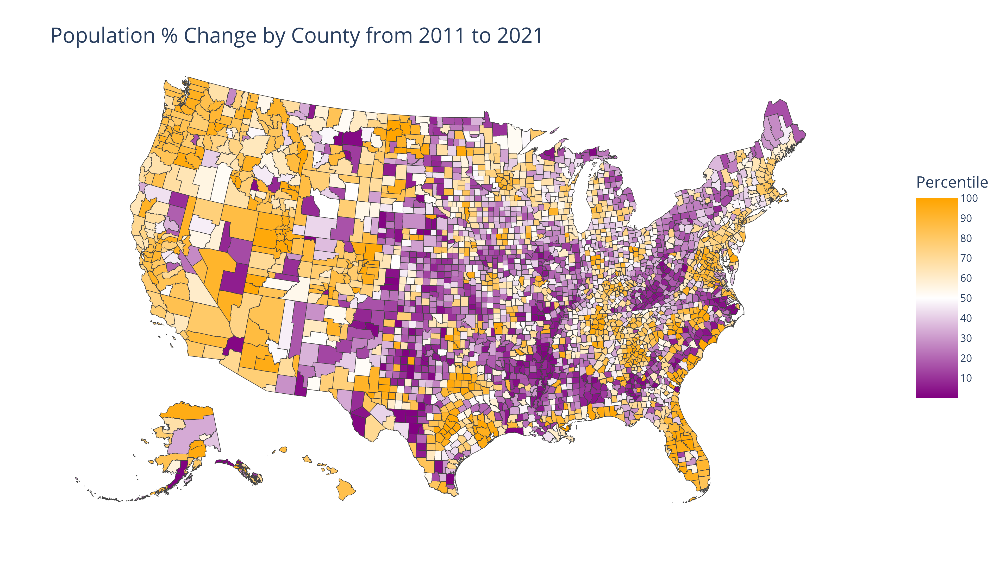

In [13]:
fig = px.choropleth(
    gdf_counties_for_map, 
    geojson = gdf_counties_for_map['geometry'],
    locations = gdf_counties_for_map.index,
    color = '2011-2021 Total_Pop % Change Percentile',
    hover_data = [data_col] + extra_hover_data, 
    color_continuous_scale = custom_color_scale,
    scope = 'usa',
title = f'Population % Change by County from {year_range_start} \
to {year_range_end}',
basemap_visible = False)
fig.update_coloraxes(colorbar_title = "Percentile")

filename = 'sample_percentile_map'
update_and_save_plotly_map(
    fig, static_file_folder = static_file_folder, filename = filename, 
    save_html = False)
wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = display_type)

This map is much more colorful--and, as a result, easier to interpret--than the version that used a linear color scale. However, a significant drawback is that the legend no longer shows the actual percentage change values on which the percentiles are based. Viewers can hover over counties to identify these values within the HTML copy of this map, but this approach is more cumbersome and won't work at all when the map is converted to a static image.

Thankfully, using Plotly's `update_coloraxes()` function, we can replace the **percentiles** in the colorbar with **the actual percentage change values** to which they correspond. We'll do so by modifying two properties of the colorbar:

1. `colorbar_tickvals`, which specifies where along the colorbar (e.g. from the lowest percentile to the highest) we'd like to add text labels. (We'll set this property to specific percentile ranks within our dataset.)
2. `colorbar_ticktext`, which specifies what text we'd like to place at those values. (We'll set this property to the actual values within our dataset that correspond to the percentile ranks that we passed to `colorbar_tickvals`.)

Making these changes will require some additional code, but the result will be well worth it. (And don't worry--I'll introduce a function shortly that will take care of these steps for you, though I think it's still valuable to know how it works.)

### Specifying how many data points we'd like to include within our color scale

In [14]:
colorscale_tick_count = 11
quantile_increment = 1/(colorscale_tick_count - 1) 
# This variable will determine
# the distance between increments within np.arange(), which we'll call
# below in order to determine which quantiles to retrieve from 
# the DataFrame.
# I subtracted 1 from the denominator so that the final number of
# quantiles (which will include both a minimum and maximum value)
# will match the 'quantile quantity' specified within 
# colorscale_tick_count.
quantile_increment

0.1

We've now designated how many values to show within the colorbar. Next, we'll want to figure out which actual percentile ranks within our dataset can function as relatively equally-spaced colorscale label locations.

### Using `quantile_increment` to specify which quantiles to retrieve

`quantile_range` will increase from 0 to 1 by the amount specified in `quantile_increment`. `quantile_increment/2` is added to 1 in the function call in order to ensure that the output will include, but also stop at, 1.

In [15]:
quantile_range = np.arange(0, 1+quantile_increment/2, 
                           quantile_increment)
quantile_range

array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

### Finding the actual percentile ranks within our DataFrame that correspond to these quantiles

We'll now identify which percentile ranks match the quantiles specified above. (A quantile of 0 refers to the smallest percentile rank in the dataset, while a quantile of 1 refers to the highest percentile rank; a quantile of 0.5, if specified, refers to the median percentile rank.)

You might be wondering why I'm finding the *percentile ranks*, and not the original data points, that correspond to these quantiles. (If you're not, feel free to skip the following explanation!) 

Initially, I *did* try to map quantiles directly to my data values when creating my revised colorbars. This entailed the following steps:

1. I used `quantile()` to figure out which data column *values*, rather than percentile ranks, to pass to the `colorbar_ticktext` property discussed earlier.
2. I then multiplied `quantile_range()` by 100 to create a range of percentile ranks (which I labeled, not very creatively, `percentile_range`) that could be passed to the `colorbar_tickvals' property.
  
However, this approach had a significant flaw: because datasets often wouldn't have an exact copy of one of the percentile ranks in `percentile_range`, the scores that replaced those percentile ranks often corresponded to a slightly different percentile rank. (In one actual example, Pandas calculated the quantile of 0.5 (e.g. the 50.000th percentile) as 6.289%, but this percentage actually represented the 50.98th percentile. It would therefore be inaccurate to replace the 50th-percentile marker in the colorbar with this value.)

In order to avoid this issue, I revised the code so that it would find the quantiles of the actual *percentile ranks* in our dataset. This way, all of the percentile ranks passed to `colorbar_tickvals` would have actual corresponding values that could be passed to `colorbar_ticktext`.

In [16]:
percentile_col = f'{year_range} Total_Pop % Change Percentile'
# Finding the quantiles of these percentiles: (See notes above for
# my reasoning behind this approach.)
gdf_county_percentile_quantiles = gdf_counties_for_map[
percentile_col].quantile(
    quantile_range, interpolation = 'lower').sort_values(ascending = False)
# The 'lower' interpretation method helps ensure that only 
# actual percentile ranks present in the DataFrame get retrieved.
# This is a necessary prerequisite for using df.query() to locate
# the scores that match these percentile ranks, which we'll do shortly.
print(f"{len(gdf_county_percentile_quantiles)} quantiles created.") 
gdf_county_percentile_quantiles

11 quantiles created.


1.0    100.000000
0.9     89.990437
          ...    
0.1     10.009563
0.0      0.031878
Name: 2011-2021 Total_Pop % Change Percentile, Length: 11, dtype: float64

Saving these percentile ranks as a list:

In [17]:
gdf_county_percentile_quantile_list = (
    gdf_county_percentile_quantiles.to_list())
gdf_county_percentile_quantile_list

[100.0,
 89.99043672298374,
 79.98087344596748,
 70.00318775900541,
 59.99362448198916,
 50.01593879502709,
 40.00637551801084,
 29.99681224099458,
 20.019126554032518,
 10.009563277016255,
 0.0318775900541919]

Determining the actual `data_col` values within the dataset that correspond to these percentile ranks:

Note that only one row will be retained for each percentile rank; this will ensure that the lengths of the percentile rank and percentile score lists match. (If these lengths differed, we could encounter issues when trying to replace the former with the latter within our colorbar.)

In [18]:
df_county_percentile_rank_score_pairs = gdf_counties_for_map.query(
    f"`{percentile_col}` in @gdf_county_percentile_quantile_list"
).drop_duplicates(percentile_col).copy()
df_county_percentile_rank_score_pairs.head()

,geometry,2011-2021 Total_Pop % Change,2011-2021 Total_Pop % Change Percentile,2011-2021 Total_Pop % Change Rank
County/State,,,,
"McKenzie County, North Dakota","POLYGON ((-104.04531 47.33014, -104.04412 47.9...",119.770042,100.000000,1.0
"Lubbock County, Texas","POLYGON ((-102.08573 33.82468, -101.56358 33.8...",12.473074,89.990437,315.0
"Tillamook County, Oregon","POLYGON ((-124.01799 45.04981, -124.00606 45.0...",7.445839,79.980873,629.0
"Lexington city, Virginia","POLYGON ((-79.46158 37.78636, -79.43712 37.794...",4.129751,70.003188,942.0
"Scott County, Kansas","POLYGON ((-101.12838 38.7006, -100.68801 38.70...",1.814238,59.993624,1256.0


Note that McKenzie County's population growth was nearly *10 times* that of the 90th-percentile county in our list. It's no wonder that a linear scale didn't work very well! McKenzie effectively 'broke the curve' for all the other counties.

Rounding these percentile scores (so that they'll display better within our colorbar), then saving them to a list:

In [19]:
round_val = 1

In [20]:
gdf_county_score_list = df_county_percentile_rank_score_pairs[
data_col].round(round_val).to_list()
gdf_county_score_list

[119.8, 12.5, 7.4, 4.1, 1.8, -0.2, -1.9, -3.8, -5.6, -8.6, -48.0]

We've now calculated (1) percentile ranks at 11 different quantiles and (2) the data values that correspond to those ranks. This is the information we'll need to update our colorbar!

### Rendering an improved percentile-based choropleth map

This percentile map will incorporate both a percentile-based scale *and* colorbar labels that show the values corresponding to those percentiles.

First, I'll use some simulated data to demonstrate that `colorbar_tickvals` determines where items are placed on the colorbar, whereas `colorbar_ticktext` shows what their values will be. I hope that this example will make our actual map updates clearer.

Modifying `colorbar_tickvals` to designate where colorbar labels will be placed:

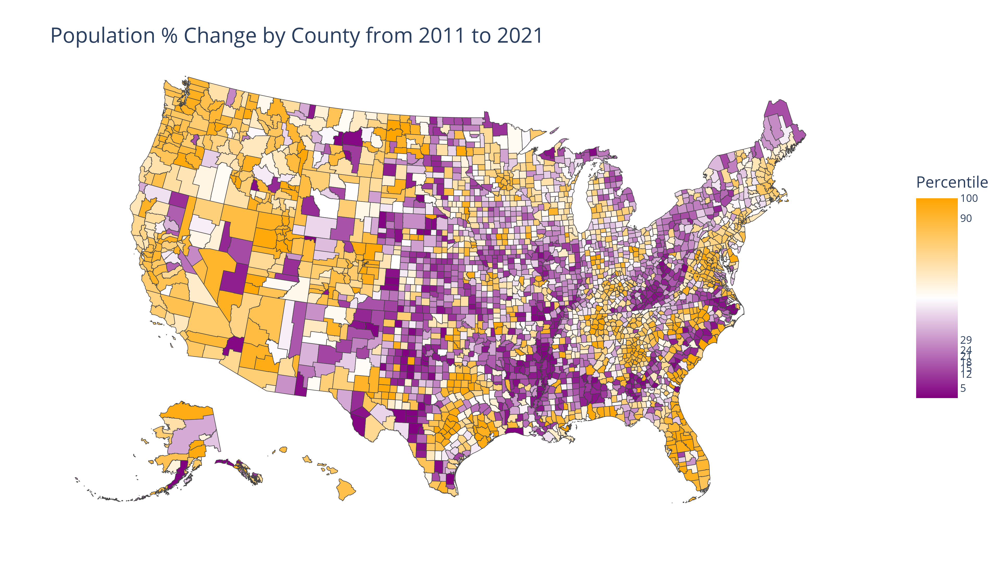

In [21]:
sample_colorbar_tickvals = [5, 12, 15, 18, 21, 24, 29, 90, 100]
fig.update_coloraxes(colorbar_tickvals = sample_colorbar_tickvals)
filename = 'sample_tickval_change'
update_and_save_plotly_map(
    fig, static_file_folder = static_file_folder, filename = filename, 
    save_html = False)
wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = display_type)

There are two important things to note here: (1) the colorbar labels are now located at the percentiles specified by `sample_colorbar_tickvals`, and (2) the labels themselves have been updated to match these percentiles. 

Modifying `colorbar_ticktext` to replace these labels with letters of the alphabet: (this is simply to demonstrate that we can change the text entries for colorbar labels without also modifying their position.)

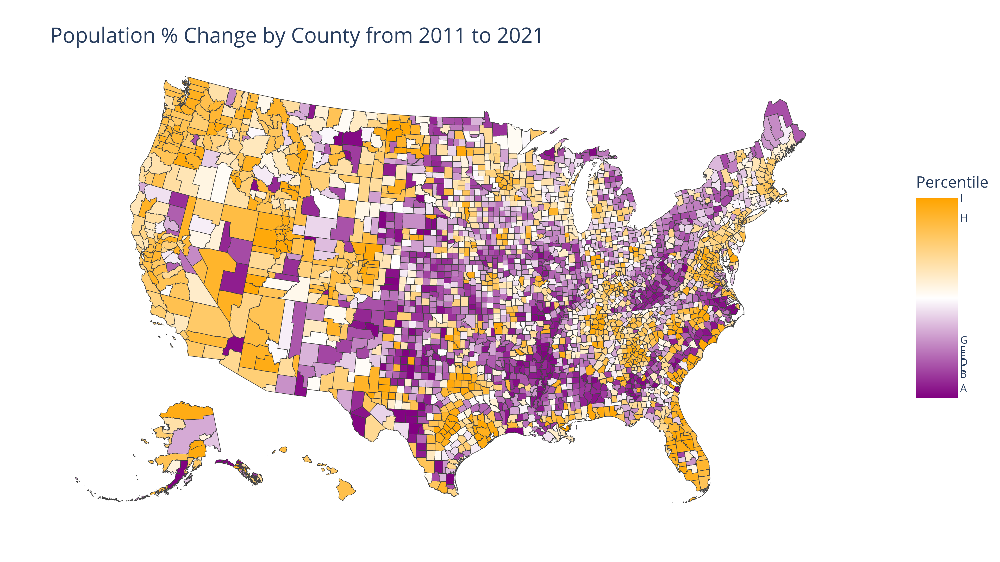

In [22]:
sample_colorbar_ticktext = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I']
fig.update_coloraxes(colorbar_ticktext = sample_colorbar_ticktext)
filename = 'sample_ticktext_change'
update_and_save_plotly_map(
    fig, static_file_folder = static_file_folder, filename = filename, 
    save_html = False)
wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = display_type)

The positions of the labels haven't changed, but their values have.

Now that we've gotten this example out of the way, let's *finally* update the map to incorporate our real-life replacements for the `colorbar_tickvals` and `colorbar_tickmode` arguments.

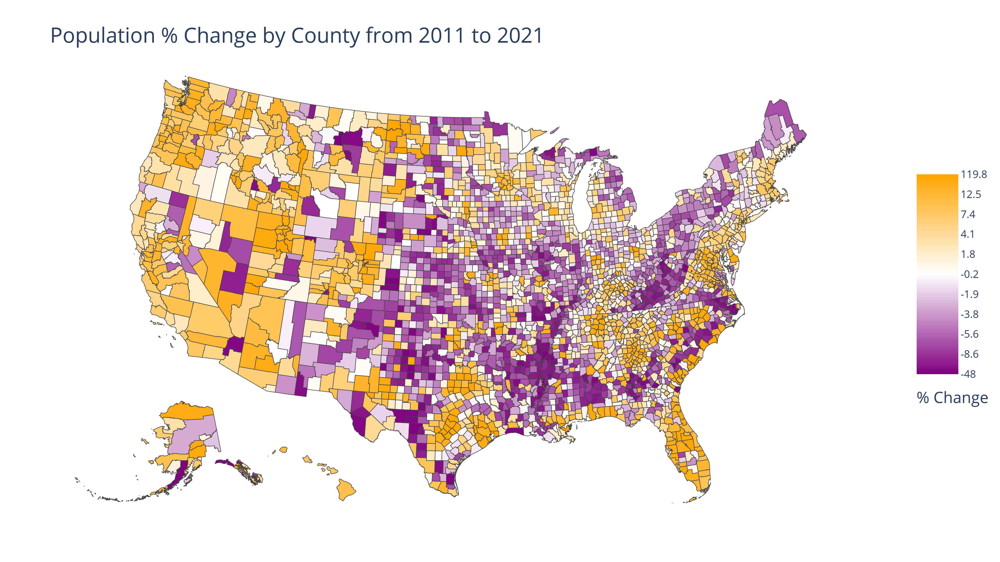

In [23]:
# The following code updates the colorbar to show the values 
# corresponding to each percentile rather than the percentiles 
# themselves. It does so by (1) 
# selecting the percentile quantiles calculated earlier 
# as the colorbar tick locations; (2) selecting these quantiles' 
# corresponding percentile scores as the colorbar values; 
# and (3) changing the title of the colorbar to reflect
# the nature of the data being displayed within the tick text entries.

fig.update_coloraxes(
    colorbar_tickvals = gdf_county_percentile_quantile_list,
    colorbar_tickmode = 'array',
    colorbar_ticktext = gdf_county_score_list,
    colorbar_title = "% Change",
    colorbar_title_side = 'bottom')
# The documentation at 
# https://plotly.com/python/reference/layout/coloraxis/
# proved indispensable when drafting this code.

# Note: I chose to place the colorbar title below the colorbar (via
# "colorbar_title_side = 'bottom'") because it ended up pretty close to 
# the topmost tick when the default setting ('top') was used.)

filename = f'county_pop_pct_growth_{year_range_start}\
-{year_range_end}'
update_and_save_plotly_map(
    fig, static_file_folder = static_file_folder, 
    html_file_folder=html_file_folder, filename = filename)

wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = display_type)

We now have a map that shows percentile-based colors, yet also displays actual data points within the colorbar. This is a big improvement over the original linear-based map.

## Mapping 25-to-29-year-old population growth at the county level

We'll next generate a map that displays population growth for adults in their mid-to-late 20s. To speed things up, it will apply `gen_choropleth()`, a function stored within `plotly_choropleth_map_functions.py`, to produce *and* save this visualization. Much of its code is very similar to the code we just ran to create our revised percentile-based map.

First, we'll specify a few key values:

In [24]:
young_data_col = f'{year_range} Total_Pop_25_to_29 % Change'
young_extra_hover_data = [
    f'{young_data_col} Rank']
young_data_col

'2011-2021 Total_Pop_25_to_29 % Change'

Next, we'll call `gen_choropleth()` to create, then save this map. More information on the parameters this function uses can be found within the function's documentation.

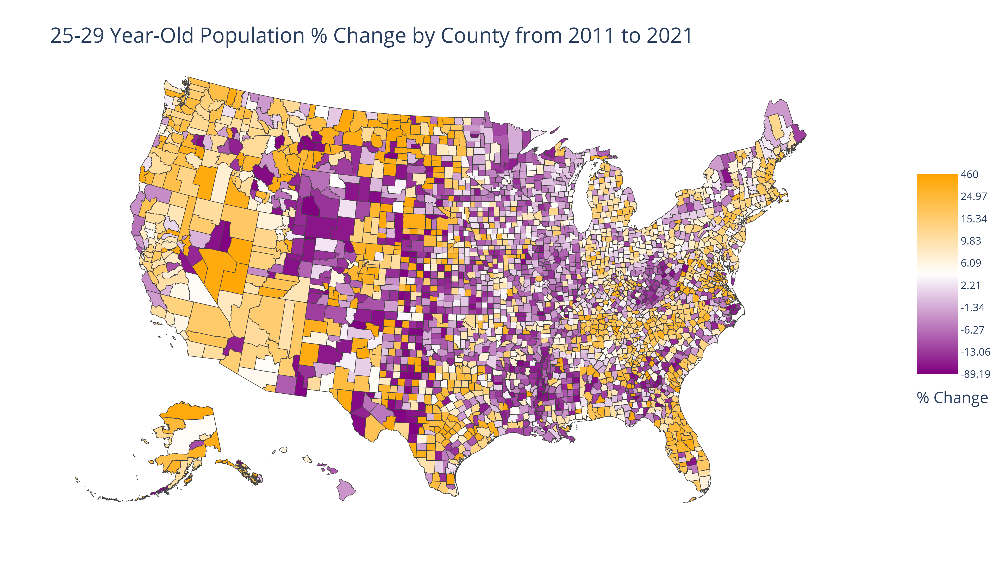

In [25]:
filename = f'county_25-29_pop_pct_growth_{year_range_start}\
-{year_range_end}'
fig=gen_choropleth(
    original_gdf=gdf_counties_and_growth_stats, 
    geojson_col='geometry', location_name_col='County/State',
    data_col=young_data_col, extra_hover_cols=young_extra_hover_data, 
    color_continuous_scale=custom_color_scale,
    scope='usa', title=f'25-29 Year-Old Population % Change by \
County from {year_range_start} to {year_range_end}',
    basemap_visible=False, colormap_type='percentile',
    colorscale_tick_count=10,
    tick_round_value=2,
    static_file_folder=static_file_folder,
    html_file_folder=html_file_folder,
    filename=filename,
custom_colorbar_title='% Change',
add_labels=False,
label_round_value=1)

wadi(fig, static_file_folder+'/'+filename, generate_image=False,
     display_type='png')

Note that this map shows an even wider range in population growth rates than our previous one; this makes the use of percentile-based colors even more crucial here.

## Performing simliar steps to map state-level growth data

We'll perform a similar set of steps to visualize population growth data at the state level.

In [26]:
gdf_states = geopandas.read_file(
    'shapefiles/cb_2023_us_state_500k/cb_2023_us_state_500k.shp')
gdf_states['geometry'] = gdf_states['geometry'].simplify(
    tolerance = 0.005)

gdf_states.head()

,STATEFP,STATENS,...,AWATER,geometry
0,35,00897535,...,726463919,"POLYGON ((-109.05004 31.3325, -109.04522 36.99..."
1,46,01785534,...,3387709166,"POLYGON ((-104.05788 44.9976, -104.03969 44.99..."
2,06,01779778,...,20291770234,"MULTIPOLYGON (((-118.60442 33.47855, -118.5386..."
3,21,01779786,...,2384223544,"MULTIPOLYGON (((-89.41728 36.49901, -89.37637 ..."
4,01,01779775,...,4582326383,"MULTIPOLYGON (((-88.05338 30.50699, -88.03867 ..."


In [27]:
df_acs_state_growth = pd.read_csv(
    f'../Census_Data_Imports/Datasets/\
grad_destinations_acs_state_data.csv')
df_acs_state_growth.rename(
    columns = {'state':'state_code'},
    inplace = True)
gdf_states_and_growth_stats = gdf_states.merge(
    df_acs_state_growth, on = 'NAME', how = 'inner').rename(
    columns = {'NAME':'State'})
gdf_states_and_growth_stats.query("State != 'Puerto Rico'", 
                                    inplace = True)
gdf_states_and_growth_stats.head()

,STATEFP,STATENS,...,2016-2021 Total_Pop_25_to_29 % Change Rank,2016-2021 Total_Pop_25_to_29 % Change Percentile
0,35,00897535,...,36.0,31.372549
1,46,01785534,...,39.0,25.490196
2,06,01779778,...,30.0,43.137255
3,21,01779786,...,16.0,70.588235
4,01,01779775,...,25.0,52.941176


### Rendering state-level maps

We'll first use `gen_choropleth()` to create a map of total population growth; next, we'll map population growth for the 25-29 age range.

These maps will also display population growth rates atop each state. Such labels are especially useful for static map copies, but you may want to consider including them within HTML-based maps as well.

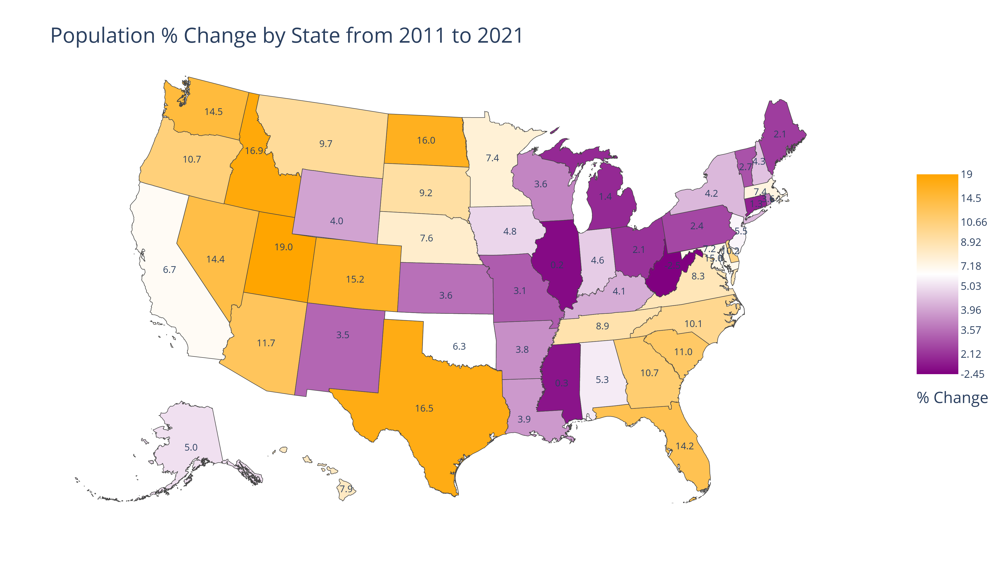

In [28]:
filename = f'state_pop_pct_growth_{year_range_start}\
-{year_range_end}'
fig = gen_choropleth(
    original_gdf=gdf_states_and_growth_stats, geojson_col='geometry', 
    location_name_col='State',
    data_col=data_col, extra_hover_cols=extra_hover_data, 
    color_continuous_scale=custom_color_scale,
    scope='usa', title=f'Population % Change by \
State from {year_range_start} to {year_range_end}',
    basemap_visible=False, colormap_type='percentile',
    colorscale_tick_count=10,
    tick_round_value=2,
    static_file_folder=static_file_folder,
    html_file_folder=html_file_folder,
    filename = filename,
custom_colorbar_title = '% Change',
add_labels = True,
label_round_value = 1,
revise_state_label_points = True)

wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = display_type)

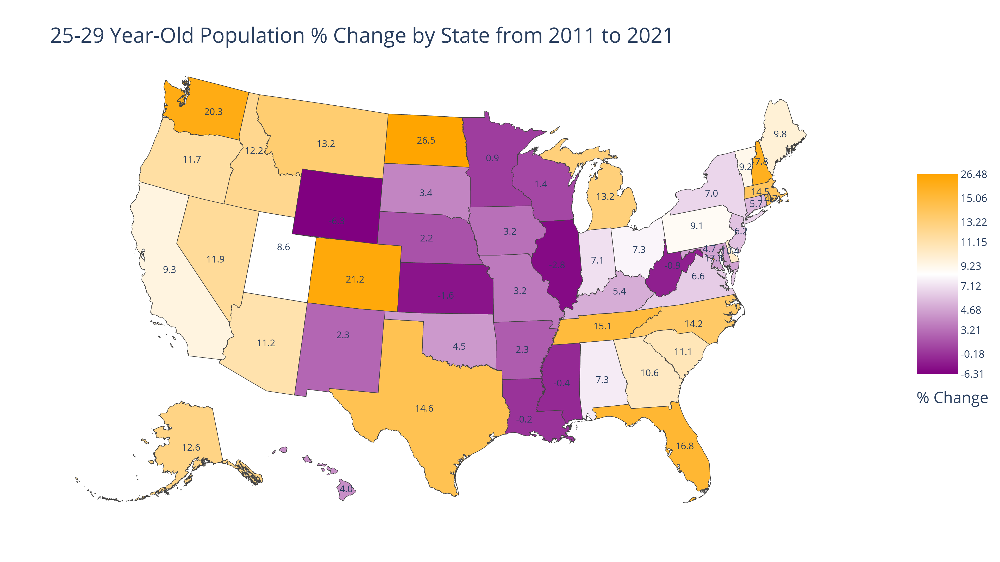

In [29]:
filename = f'state_25-29_pop_pct_growth_{year_range_start}\
-{year_range_end}'
fig = gen_choropleth(
    original_gdf=gdf_states_and_growth_stats, geojson_col='geometry', 
    location_name_col='State',
    data_col=young_data_col, extra_hover_cols=young_extra_hover_data, 
    color_continuous_scale=custom_color_scale,
    scope='usa', title=f'25-29 Year-Old Population % Change by \
State from {year_range_start} to {year_range_end}',
    basemap_visible=False, colormap_type='percentile',
    colorscale_tick_count = 10,
    tick_round_value=2,
    static_file_folder=static_file_folder,
    html_file_folder=html_file_folder,
    filename = filename,
custom_colorbar_title = '% Change',
add_labels = True,
label_round_value = 1,
revise_state_label_points = True)

wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type = display_type)

## Creating tiled choropleth maps

The choropleth maps created thus far do not show any background images that can help users identify the regions specified within the maps. (These images are often referred to as 'tiles.') In order to include such tiles, we'll need to use a separate Plotly function: `px.choropleth_map()`. (More information on this function can be found at https://plotly.com/python-api-reference/generated/plotly.express.choropleth_map.html .) 

Tiled maps have a few significant advantages:

1. They can make areas of the map easier to identify. For instance, if you want to figure out which cities are contained within a particular county in one of the 'tileless' maps created earlier, you'd need to search for them within a separate map. Tiled maps include that 'separate map' as an underlying layer; as a result, you could simply zoom in on the county in question and review the cities that appear within it.

2. I have found that zooming and scrolling within HTML versions of tiled maps is a smoother process than it is for the non-tiled HTML-based maps shown above. I *think* this is because the non-tiled maps made use of the Albers USA projection, which might require more processing power than the tiled maps we'll create shortly.

The main advantage of the *tileless* maps we created earlier, at least for the US, is that they support the Albers USA projection; this projection makes it easy to include Alaska and Hawaii within static versions of the map. They also offer a simpler, cleaner display that works great for certain maps (such as state-based ones) for which tiles don't add that much explanatory value.

In general--at least for US-based maps--I would recommend using a non-tiled setup for static maps and a tiled one for HTML-based ones. 

### Creating a simple tiled map

Before we create a tiled *choropleth* map, let's first see what a standard Plotly tiled map looks like.

The following cell calls `px.choropleth_map()` to create a tiled map of the lower 48 US states. Within the `choropleth_map()` call, we'll specify our tile provider* as well as the starting zoom and center of our map. After creating the map, we'll also remove all margins from our map so that it takes up more of the screen. (I've found that this can be particularly useful for tiled maps.)

*There are other tile providers that you can use as well. However, you'll want to look into the terms of service for each one in order to determine whether you need to pay, register, etc. in order to use the tiles for personal and/or commercial use. For instance, before using CARTO-based tiles in a commercial setting, you should reach out to CARTO to determine how much such usage would cost.)

Relevant resources for OpenStreetMap tile and data usage include:

* https://operations.osmfoundation.org/policies/tiles/

* https://opendatacommons.org/licenses/odbl/

* https://osmfoundation.org/wiki/Licence/Licence_and_Legal_FAQ


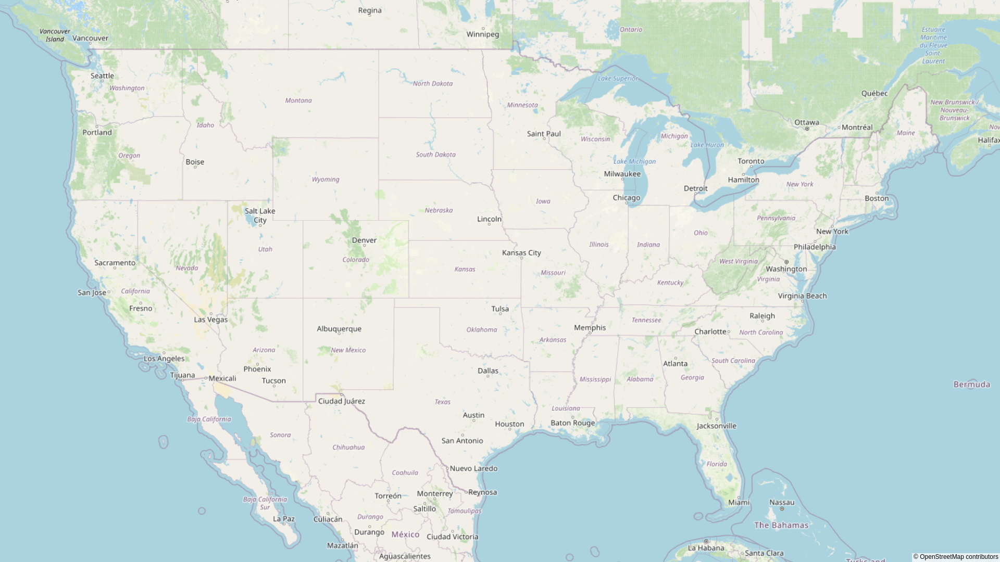

In [30]:
fig_simple_cm = px.choropleth_map(map_style='open-street-map', zoom=4.35, 
    center={'lat':37.9, 'lon':-96}).update_layout(margin = {
                    "r":0,"t":0,"l":0,"b":0})

# This update_layout() call was taken from
# https://plotly.com/python/map-configuration/ .

# When saving the file as an image, I'll choose a larger-than-usual
# height setting so that the tiles will appear more clearly.
# In later examples, I'll actually render tiled choropleth maps in
# UHD (3840 x 2160) format for even more clarity.

wadi(fig_simple_cm, file_path = 'simple_choropleth_map', 
     generate_image = True, html_path_prefix = 'maps/',
     static_path_prefix = 'map_screenshots/',display_type = display_type,
    debug = False, height = 1080, scale = 1)

This graphic differs from the ones created earlier in that it shows map data in the form of tiles. (The previous maps showed state and county outlines from the Census, but there were no tiles underlying them--just a blank background.)

If you zoom in on an HTML copy of this map (available within maps/simple_choropleth_maps.html), you'll find that the map data becomes even more detailed: if you go in far enough, you'll begin to see street names and the outlines of individual buildings.

However, while this map is neat, we can get essentially the same experience by visiting https://www.openstreetmap.org/#map=5/37.9/-96 . Therefore, let's now make this map more useful by overlaying choropleth data onto the tiles.

### Creating tiled choropleth maps via a for loop

The following code will create four new tiled versions of our county-level population change maps. It will do by calling `gen_choropleth_map()`, a variant of `gen_choropleth()` that calls `px.choropleth_map()` rather than `px.choropleth()`. (This function's documentation, like that for `gen_choropleth()`, is available within 'folium_choropleth_map_functions.py'.

In order to reduce the amount of code required for this section, we'll generate these maps within a for loop. This loop will first create total population growth maps; next, it will build growth maps for the 25-29-year-old population. 

For each of these map types, the code will first create a map optimized for HTML display followed by one designed to be viewed as a screenshot. The HTML- and PNG-optimized maps will be saved only in HTML and PNG format, respectively. Configuration settings for these two map types can be found within `options_dict_list`.

A few additional notes on this code:

1. In order to compensate for these wider dimensions, the PNG-optimized maps use higher zoom and font size settings than the standard ones.
2. The HTML-based maps do not include a title. I have found that the presence of these titles can make these maps harder to view when their underlying windows are compressed.

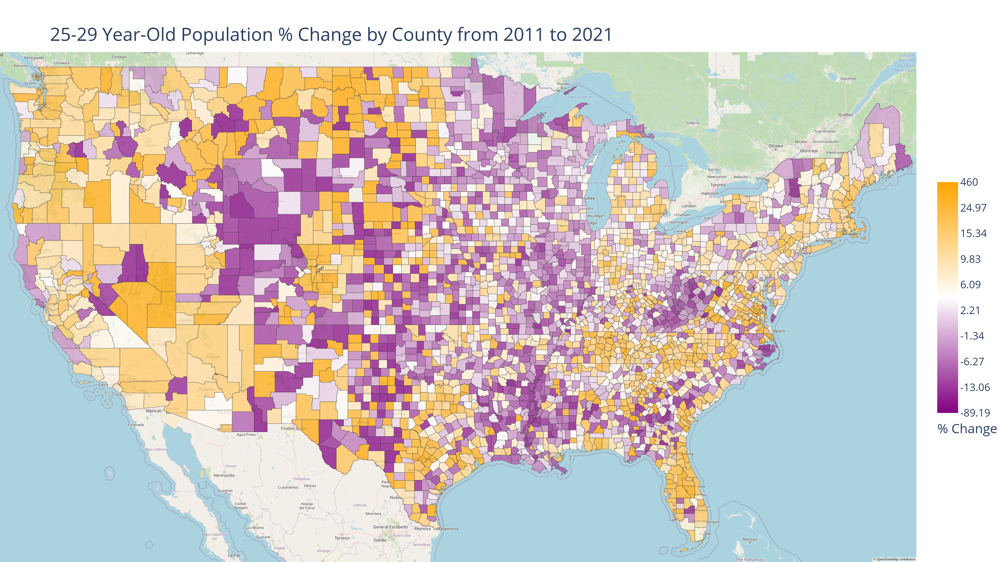

In [31]:
for pop_type in ['', '25-29_']: # These variables refer to all residents
    # and residents aged 25-29, respectively. I chose these values
    # so that they could be incorporated more easily into our 
    # map filenames.
    if pop_type == '':
        pop_type_for_title = ''
        tiled_data_col = data_col
        extra_hover_cols = extra_hover_data
    if pop_type == '25-29_':
        pop_type_for_title = '25-29 Year-Old '
        tiled_data_col = young_data_col
        extra_hover_cols = young_extra_hover_data
    
    filename = f'county_{pop_type}pop_pct_growth_{year_range_start}\
-{year_range_end}_tiled'
    # Specifying which arguments to use for our static and interactive 
    # maps:
    # (The first set of options will be used for HTML-based maps, and 
    # the second set will be applied for PNG-based maps.)
    options_dict_list = [{'zoom':4.3, 'save_static':False, 
                          'save_html':True, 'title':''},
    {'zoom':5.4, 'save_html':False, 'save_static':True,
    'title':f'{pop_type_for_title}\
Population % Change by County from {year_range_start} \
to {year_range_end}'}]
    
    for options_dict in options_dict_list:
        fig = gen_choropleth_map(
            original_gdf=gdf_counties_and_growth_stats, 
            geojson_col='geometry', 
            location_name_col='County/State',
            data_col=tiled_data_col, extra_hover_cols=extra_hover_cols, 
            color_continuous_scale=custom_color_scale,
            title=options_dict['title'],
            colormap_type='percentile',
            colorscale_tick_count = 10,
            tick_round_value=2,
            static_file_folder=static_file_folder,
            html_file_folder=html_file_folder,
            filename = filename,
        custom_colorbar_title = '% Change',
        add_labels = False, 
            zoom = options_dict['zoom'],
            save_static = options_dict['save_static'],
            save_html = options_dict['save_html'])
    
# Displaying the static image created within the final entry in 
# the for loop:
wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type=display_type)

### Creating tiled state-level maps

Finally, we'll create two tiled state-level maps, one HTML based and one PNG based, that display total population growth between 2011 and 2021. These maps will also include state-level data labels.

**Note**: This code often (but not always) produces the following error when attempting to save the PNG-based map:

`ValueError: Transform failed with error code 525: Map error.`

This only seems to occur when attempting to save tile-based maps with labels. There has been some discussion of this error online, but I wasn't able to find a solution. (However, I found at one point that, after exiting and restarting JupyterLab, the error message disappeared and I was able to save the PNG copy of the map successfully.)

If you need to save a PNG version of a labeled choropleth map and are getting this error on your end also, consider using `gen_choropleth()` rather than `gen_choropleth_map()`. You should able to create a PNG file via Selenium (see the Folium mapping sections for relevant code). (If you don't need to automate this step, you could of course also just open up the map in a web browser, then generate a screenshot yourself.)

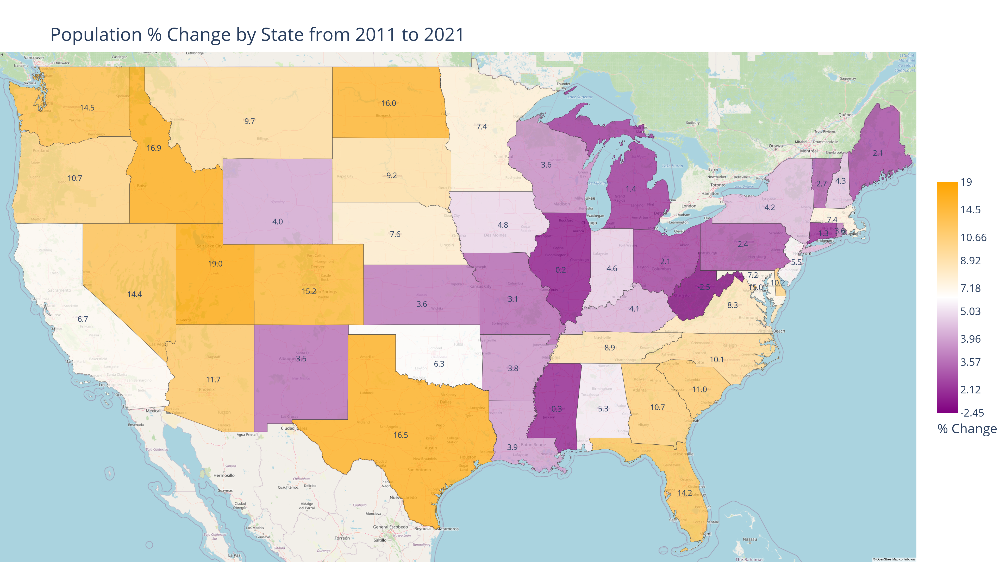

In [32]:
options_dict_list = [{'zoom':4.3, 'save_static':False, 
                      'save_html':True, 'title':''},
{'zoom':5.4, 'save_html':False, 'save_static':True,
 'title':f'Population % Change by \
State from {year_range_start} to {year_range_end}'}]
filename = f'state_pop_pct_growth_{year_range_start}\
-{year_range_end}_tiled'
for options_dict in options_dict_list:
    try:
        gdf = gen_choropleth_map(
            original_gdf=gdf_states_and_growth_stats,
            geojson_col='geometry', 
            location_name_col='State',
            data_col=data_col, extra_hover_cols=extra_hover_data, 
            color_continuous_scale=custom_color_scale,
            title=options_dict['title'],
            colormap_type='percentile',
            colorscale_tick_count=10,
            tick_round_value=2,
            label_round_value = 1,
            revise_state_label_points = True,
            static_file_folder=static_file_folder,
            html_file_folder=html_file_folder,
            filename=filename,
            custom_colorbar_title='% Change',
            add_labels=True, 
            zoom=options_dict['zoom'],
                save_static = options_dict['save_static'],
                save_html = options_dict['save_html'])
    except:
        print("Failed to generate map. (This happens at times when \
attempting to save screenshots of tiled choropleth maps with labels; \
I'm not sure why.)")

# If the function failed to save the PNG-optimized map, the copy shown 
# below will be a previously-generated one.
wadi(fig, static_file_folder+'/'+filename, generate_image = False,
     display_type=display_type)

## Saving GeoDataFrames

If you need to reuse a GeoDataFrame in another script, you can save it as a .json file via Geopandas' `to_file()` function. (This function's documentation page is located at https://geopandas.org/en/v0.14.4/docs/reference/api/geopandas.GeoDataFrame.to_file.html .)

Here's an example of this function in use:

In [33]:
gdf_states_and_growth_stats[[
    'State', '2011-2021 Total_Pop % Change', 
    'geometry']].to_file(
    'states_and_growth_stats_subset.json')

(This file can then get read back into a GeoDataFrame via Geopandas' `read_file()` function.)

That's it for this notebook! We could have covered other map types as well, such as ones that show individual points, but the lessons that you've learned here--and the source code in 'plotly_choropleth_map_functions.py'--should prove useful for all sorts of visualization projects.

In [34]:
end_time = time.time()
run_time = end_time - start_time
print(f"Finished running script in {round(run_time, 3)} seconds.")

Finished running script in 42.55 seconds.
